In [ ]:
#pip install pandas
#pip install numpy
#pip install matplotlib
#pip install mapclassify 
#pip install folium
#pip install geopandas
#pip install partial
#pip install datetime

In [1]:
import pandas as pd
import numpy as np
import matplotlib as plt
import seaborn as sns
import datetime
import json
import csv

import folium
from folium.features import GeoJson, GeoJsonTooltip, GeoJsonPopup

import geopandas as gpd
from functools import partial

In [2]:
# 1 Berlin mapa

# Координаты центра Берлина
berlin_coords = [52.5200, 13.4050]

#import folium
#m = folium.Map(location=[latitude, longitude], zoom_start=10)
#folium.Marker([lat, lon], popup='Marker Name').add_to(m)
#m.save('map.html')

'''
def __init__(location=None,
             width='100%',
             height='100%',
             left='0%',
             top='0%',
             position='relative',
             tiles='OpenStreetMap',
             #tiles="cartodb positron", # бледный фон для карты
             attr=None,
             min_zoom=0,
             max_zoom=18,
             zoom_start=10,
             min_lat=-90,
             max_lat=90,
             min_lon=-180,
             max_lon=180,
             max_bounds=False,
             crs='EPSG3857',
             control_scale=False,
             prefer_canvas=False,
             no_touch=False,
             disable_3d=False,
             png_enabled=False,
              zoom_control=True, **kwargs)'''

berlin_map = folium.Map(location=berlin_coords,
                        #width=600,
                        #height=500,
                        tiles='OpenStreetMap',
                        #tiles='white_tile',
                        scrollWheelZoom=False,
                        maxBounds=[[53, 54],[12, 13]],
                        # min_lat=50,
                        # max_lat=55,
                        # min_lon=12,
                        # max_lon=13,
                        crs='EPSG3857',
                        control_scale=True,                        
                        zoom_control=True,
                        dragging=True,
                        min_zoom=10,
                        max_zoom=25,
                        zoom_start=10)

# folium.GeoJson(data,
#                 #style_function=style_function
#                 style_function = partial(
#                         style_function, 
#                         colors_by_part.get(element, #colors_by_part[element], 
#                         'grey')) # element
#                 ).add_to(berlin_map)


# location=None, popup=None, tooltip=None, icon=None, draggable=False, **kwargs)
folium.Marker(location=berlin_coords,
              popup='Berlin',
              draggable=False,
              ).add_to(berlin_map)

berlin_map

In [3]:
# 2 Berlin mapa - Загрузка геоданных (пример:  Берлин)
gdf = gpd.read_file('Geo data/berlin.geojson')
#gdf = gpd.read_file('Geo data/mitte.geojson')
gdf
# # Добавление GeoJSON слоя границ Берлина на карту
folium.GeoJson(gdf.boundary).add_to(berlin_map)
# gdf = gpd.read_file('Geo data/spandau.geojson')
# folium.GeoJson(gdf.boundary).add_to(berlin_map)
gdf.explore()
# berlin_map

In [4]:
# 3 data
# Функция для задания стиля
# def style_function(feature):
#     return {
#         'color': ' olive',  # цвет линий
#         'weight': 1,      # толщина линий
#         'opacity': 1      # прозрачность линий  }

#    style_function =
                    #    lambda x: {'fillColor': 'grey',
                    #               'fillOpacity': 0.1, #0.05+d,
                    #               'color': 'green',
                    #               'weight': 0.75,
                    #               'opacity': 1 }

parts = [
         'mitte.geojson',
         'friedrichshain.geojson',
         'kreuzberg.geojson',
         'pankow.geojson',
         'charlottenburg-wilmersdorf.geojson',
         'spandau.geojson',
         'steglitz-zehlendorf.geojson',
         'tempelhof-schöneberg.geojson',
         'neukölln.geojson',
         'marzahn-hellersdorf.geojson',
         'reinickendorf.geojson',
         'lichtenberg.geojson',
         'treptow-köpenick.geojson'
         ]

# 3 Bezirkskoordinaten
berlin_coords = [52.5200, 13.4050]
berlin_Stadtteil_coords = {
    'Mitte': [52.5370, 13.3570], # [52.3100, 13.2200], +
    'Friedrichshain':  [52.5170, 13.4330], #[52.5670, 13.4330],
    'Kreuzberg': [52.5000, 13.3930], #[52.3330, 13.43330],
    'Pankow': [52.5670, 13.4330], #[52.5000, 13.4330], # +
    'Charlottenburg-Wilmersdorf': [52.4927, 13.2443], # + _, 13.2643
    'Spandau': [52.5330, 13.1670], # +
    'Steglitz-Zehlendorf': [52.4530, 13.2500], # + 
    'Tempelhof-Schöneberg': [52.4770, 13.3630], # + 
    'Neukölln': [52.4730, 13.4300], # + 52.4530, 13.4500    
    'Marzahn-Hellersdorf': [52.50450, 13.5667], #[52.5372, 13.3838], # + 
    'Reinickendorf': [52.5770, 13.2900], # 52.5670, 13.3500
    'Lichtenberg': [52.5330, 13.4700],
    'Treptow-Köpenick': [52.43450, 13.5667], # [52.50450, 13.5667]
    }

Stadtteil_einwohner_prokm = {
    'Mitte': 397.134,   
    'Friedrichshain': 293.454,
    'Kreuzberg': 293.454, # ! dubl
    'Pankow': 424.307, 
    'Charlottenburg-Wilmersdorf': 343.081, 
    'Spandau': 257.091, 
    'Steglitz-Zehlendorf': 310.446, 
    'Tempelhof-Schöneberg': 355.868,
    'Neukölln': 330.017, 
    'Marzahn-Hellersdorf': 291.948,  
    'Reinickendorf': 268.792,
    'Lichtenberg': 311.881,
    'Treptow-Köpenick': 294.081
    }

colors = ['maroon', 'firebrick', 'darksalmon',  'indianred',
          'seagreen',  'lightcoral',
          'darksalmon', 'salmon', 'lightgreen',
          'palegreen', 'mediumseagreen', 'forestgreen',
          'darksalmon'    ] 
color = ['#E6E6FA','#D8BFD8',
         '#DDA0DD','#EE82EE',
         '#DA70D6','#BA55D3',  
         '#9370DB','#8A2BE2',
          '#9400D3','#6A5ACD' 
        ]

In [5]:
# 4 Berlin mapa + Bezirke

def style_function(color, x):
    return {'fillColor': color,
            'fillOpacity': 0, #0.04, 
            'color': 'black',
            'weight': 0.75,
            'opacity': 1 }

# create new Berlin map
berlin_coords = [52.5200, 13.4050]
berlin_map = folium.Map(location=berlin_coords,
                        # width=800,
                        # height=600,
                        # tiles='OpenStreetMap',
                        # #tiles='white_tile',
                        # scrollWheelZoom=False,
                        # maxBounds=[[53, 54],[12, 13]],

                        # min_lat=52,
                        # max_lat=55,
                        # min_lon=11,
                        # max_lon=14,

                        # crs='EPSG3857',
                        # control_scale=True,
                        
                        # zoom_control=True,
                        # dragging=True,
                        min_zoom=10,
                        max_zoom=13,
                        zoom_start=11
                    )

# маркер Берлин
# location=None, popup=None, tooltip=None, icon=None, draggable=False, **kwargs)
folium.Marker(location=berlin_coords,
              popup='Berlin',
              draggable=False,
              permanent=True,
              ).add_to(berlin_map)

# цвета по районам
colors_by_part = dict()
for element in parts:
    colors_by_part[element] = colors[parts.index(element)]
    #print(f' {element=} {parts.index(element)=} {colors_by_part[element]=}')

d = 0
for element in parts:

    #1 читаем файл с данными бецирков
    path = 'Geo data/'+element
    #print(f' {element=} {path=}')
    data = gpd.read_file('Geo data/'+element)    

    bezirk = '-'.join([word.title() for word in element[:-8:].split('-') ])    
    print(element, bezirk, berlin_Stadtteil_coords[bezirk])  

    for i in range(len(parts)):       

        # 2 Добавление GeoJSON слоя на карту
        folium.GeoJson(data,
                       #style_function=style_function
                       style_function = partial(
                           style_function, 
                           colors_by_part.get(element, #colors_by_part[element], 
                                              'grey')) # element
                    
                       ).add_to(berlin_map)

        # добавоение названия района 
        folium.map.Marker(
        location=berlin_Stadtteil_coords[bezirk],
        icon=folium.DivIcon(
            html=f'<div style="font-size: 13pt; color: black;">{bezirk}</div>'
        )
        ).add_to(berlin_map)

        # названия бецирков        
        # folium.Marker(location=berlin_Stadtteil_coords[bezirk],
        #               popup=bezirk,
        #               draggable=False,
        #               ).add_to(berlin_map)
        
        #folium.Marker([lat1, lon1], tooltip='Marker 1').add_to(mymap)
        #folium.Text([52.5000, 13.4330], tooltip='Marker 1').add_to(berlin_map)
        #folium.LayerControl(collapsed=True).add_to(berlin_map)

        # точки - названия бецирков 
        # folium.CircleMarker( location=berlin_Stadtteil_coords[bezirk],
        #                     radius=5,  # Радиус круга в пикселях
        #                     popup=bezirk,
        #                     color='red',  # Цвет круга
        #                     fill=True,
        #                     fill_color='blue'
        #                     ).add_to(berlin_map)


        # -------------------------------------------------
        # 3 labels
        #label = berlin_Stadtteil_coords[ element[:-8:] ]
        #bezirk = '-'.join([word.title() for word in element[:-8:].split('-') ])
        #coords = berlin_Stadtteil_coords[bezirk]

        # folium.Marker(location=coords,
        #      popup=bezirk,
        #      draggable=False,
        #      ).add_to(berlin_map)

        #d += 0.03

# # Сохранение карты с добавленными слоями
#berlin_map.save('berlin_map.html')
#berlin_map.render()

print('Berliner Stadtplan - Bezirke')
berlin_map

mitte.geojson Mitte [52.537, 13.357]
friedrichshain.geojson Friedrichshain [52.517, 13.433]
kreuzberg.geojson Kreuzberg [52.5, 13.393]
pankow.geojson Pankow [52.567, 13.433]
charlottenburg-wilmersdorf.geojson Charlottenburg-Wilmersdorf [52.4927, 13.2443]
spandau.geojson Spandau [52.533, 13.167]
steglitz-zehlendorf.geojson Steglitz-Zehlendorf [52.453, 13.25]
tempelhof-schöneberg.geojson Tempelhof-Schöneberg [52.477, 13.363]
neukölln.geojson Neukölln [52.473, 13.43]
marzahn-hellersdorf.geojson Marzahn-Hellersdorf [52.5045, 13.5667]
reinickendorf.geojson Reinickendorf [52.577, 13.29]
lichtenberg.geojson Lichtenberg [52.533, 13.47]
treptow-köpenick.geojson Treptow-Köpenick [52.4345, 13.5667]
Berliner Stadtplan - Bezirke


In [7]:
# 6 Read Data from today's monitoring stations:
# https://aqicn.org/data-platform/

df = pd.read_csv('data_Berlin.csv') 
df.head()
today = datetime.date.today()
df_today = df[df['date']== str(today)]
print(f'active {len(df_today)} counters:')
df_today 

active 18 counters:


,date,station_id,satation_name,lat,long,pm25,pm10,o3,no2,co
379,2024-08-27,6132,"Berlin, Germany",52.520007,13.404954,30.0,11.0,10.0,NaN,NaN
380,2024-08-27,6179,"Blankenfelde-Mahlow, Germany",52.349444,13.424167,34.0,11.0,12.0,NaN,NaN
381,2024-08-27,6188,"Potsdam, Groß Glienicke, Germany",52.484167,13.123611,33.0,12.0,11.0,NaN,NaN
382,2024-08-27,6194,"Bernau, Lohmühlenstr. v, Germany",52.677500,13.582222,29.0,11.0,12.0,NaN,NaN
383,2024-08-27,6198,"Potsdam, Großbeerenstr. v, Germany",52.389817,13.090314,37.0,12.0,12.0,NaN,NaN
384,2024-08-27,6200,"Schönefeld, Flughafen*, Germany",52.376667,13.532500,31.0,11.0,12.0,NaN,NaN
385,2024-08-27,10030,"Wedding-Amrumer Str., Berlin, Germany",52.543041,13.349326,30.0,11.0,10.0,NaN,NaN
386,2024-08-27,10031,"Grunewald (3.5 m), Berlin, Germany",52.473192,13.225144,33.0,12.0,11.0,NaN,NaN
387,2024-08-27,10032,"Neukölln-Nansenstraße, Berlin, Germany",52.489451,13.430844,30.0,11.0,10.0,NaN,NaN
388,2024-08-27,10033,"Buch, Berlin, Germany",52.644169,13.483079,29.0,11.0,11.0,NaN,NaN


In [8]:
# 7 Air Pollution pm25 - анализ показателей pm25
#df_today.index #['station_id']
#print(df_today.index, end='' )

# data
values = df_today['pm25']
mmin = min(values)
mmax = max(values)
delta= (mmax - mmin) 
# print(f'{mmin=} {mmax=} delta=} ')

# create new Berlin map
berlin_coords = [52.5200, 13.4050]
map_center = berlin_coords
berlin_map = folium.Map(location=berlin_coords,
                        # width=800,
                        # height=600,
                        # tiles='OpenStreetMap',
                        # #tiles='white_tile',
                        # scrollWheelZoom=False,
                        # maxBounds=[[53, 54],[12, 13]],

                        # min_lat=52,
                        # max_lat=55,
                        # min_lon=11,
                        # max_lon=14,

                        # crs='EPSG3857',
                        # control_scale=True,
                        
                        # zoom_control=True,
                        # dragging=True,
                        min_zoom=10,
                        max_zoom=25,
                        zoom_start=10.5
                    )
#-map___----------
for element in parts:

    #1 читаем файл с данными бецирков
    path = 'Geo data/'+element
    #print(f' {element=} {path=}')
    data = gpd.read_file('Geo data/'+element)    

    bezirk = '-'.join([word.title() for word in element[:-8:].split('-') ])    
    #print(element, bezirk, berlin_Stadtteil_coords[bezirk])  # !!!!!!!!!!

    # добавление надписи - названия района
    folium.map.Marker(
        location=berlin_Stadtteil_coords[bezirk],
        icon=folium.DivIcon(
            html=f'<div style="font-size: 12pt; color: black;">{bezirk}</div>'
        )
    ).add_to(berlin_map)


    for i in range(len(parts)):       

        # 2 Добавление GeoJSON слоя на карту
        folium.GeoJson(data,
                       #style_function=style_function
                       style_function = partial(
                           style_function, 
                           colors_by_part.get(element, #colors_by_part[element], 
                                              'grey')) # element
                    
                       ).add_to(berlin_map)
#------------------

print(f'counters: ')
for x in df_today.index: #df_today['station_id']:
    print( df_today['station_id'][x], end=',')  

    # добавление надписи - номера счетчика
    number = df_today['station_id'][x]
    #print(number)    
    folium.map.Marker(
        location=[df_today['lat'][x], df_today['long'][x] ],
        icon=folium.DivIcon(
            html=f'<div style="font-size: 13pt; color: blue;">{number}</div>'
        )
    ).add_to(berlin_map)  
    
    if  mmin <= int( df_today['pm25'][x] ) <= mmin+delta/2:        
        folium.CircleMarker( location=[df_today['lat'][x], df_today['long'][x] ], #[berlin_Stadtteil_coords[bezirk]],
                         radius=6,  # Радиус круга в пикселях
                         popup=str(x),
                         color='green' ,  # Цвет круга
                         fill=True,
                         fill_color='green' 
                         ).add_to(berlin_map)
    
    elif  mmin+delta/2 < int( df_today['pm25'][x] ) <= mmax:        
        folium.CircleMarker( location=[df_today['lat'][x], df_today['long'][x] ], #[berlin_Stadtteil_coords[bezirk]],
                         radius=6,  # Радиус круга в пикселях
                         popup=str(x),
                         color='red' ,  # Цвет круга
                         fill=True,
                         fill_color='red'
                         ).add_to(berlin_map)
print()
print(today)
print(f'Air Pollution pm25: {mmin=} {mmax=} {delta=}')
berlin_map

counters: 
6132,6179,6188,6194,6198,6200,10030,10031,10032,10033,10034,10035,10038,10039,10040,13847,13851,13852,
2024-08-27
Air Pollution pm25: mmin=29.0 mmax=37.0 delta=8.0


In [9]:
# 8 Air Pollution pm10 - анализ показателей pm10
# df_today.index #['station_id']
# print(df_today.index, end='' )

values = df_today['pm10']
mmin = min(values)
mmax = max(values)
delta= (mmax - mmin) 
#print(f'{mmax=} {mmin=} {delta=} ')

# create new Berlin map
berlin_coords = [52.5200, 13.4050]
map_center = berlin_coords
berlin_map = folium.Map(location=berlin_coords,
                        # width=800,
                        # height=600,
                        # tiles='OpenStreetMap',
                        # #tiles='white_tile',
                        # scrollWheelZoom=False,
                        # maxBounds=[[53, 54],[12, 13]],

                        # min_lat=52,
                        # max_lat=55,
                        # min_lon=11,
                        # max_lon=14,

                        # crs='EPSG3857',
                        # control_scale=True,
                        
                        # zoom_control=True,
                        # dragging=True,
                        min_zoom=10,
                        max_zoom=25,
                        zoom_start=10.5
                    )

print(f'counters: ')
for x in df_today.index: #df_today['station_id']:
    print( df_today['station_id'][x], end=',') 
    
    # добавление надписи - номера счетчика
    number = df_today['station_id'][x]
    #print(number)    
    folium.map.Marker(
        location=[df_today['lat'][x], df_today['long'][x] ],
        icon=folium.DivIcon(
            html=f'<div style="font-size: 12pt; color: blue;">{number}</div>'
        )
    ).add_to(berlin_map)  
    

#-map--------------
for element in parts:

    #1 читаем файл с данными бецирков
    path = 'Geo data/'+element
    #print(f' {element=} {path=}')
    data = gpd.read_file('Geo data/'+element)    

    bezirk = '-'.join([word.title() for word in element[:-8:].split('-') ])    
    #print(element, bezirk, berlin_Stadtteil_coords[bezirk])  
    
    # добавление надписи - названия района
    folium.map.Marker(
        location=berlin_Stadtteil_coords[bezirk],
        icon=folium.DivIcon(
            html=f'<div style="font-size: 12pt; color: black;">{bezirk}</div>'
        )
    ).add_to(berlin_map)

    for i in range(len(parts)):       

        # 2 Добавление GeoJSON слоя на карту
        folium.GeoJson(data,
                       #style_function=style_function
                       style_function = partial(
                           style_function, 
                           colors_by_part.get(element, #colors_by_part[element], 
                                              'grey')) # element
                    
                       ).add_to(berlin_map)
#--------------

#c = 'grey' # draft
for x in df_today.index: #df_today['station_id']:
    #print( df_today['station_id'][x], end=',')
    #print(f'{mmin=} {mmax=} {delta=} {c=}') 
    
    if  mmin <= int( df_today['pm10'][x] ) <= mmin+delta/2:
        #c = 'g'#'#DA70D6'
        folium.CircleMarker( location=[df_today['lat'][x], df_today['long'][x] ], #[berlin_Stadtteil_coords[bezirk]],
                         radius=6,  # Радиус круга в пикселях
                         popup=str(x),
                         color='green' ,  # Цвет круга
                         fill=True,
                         fill_color='green' 
                         ).add_to(berlin_map)
    elif  mmin+delta/2 < int( df_today['pm10'][x] ) <= mmax:
        c = 'r'# '#8A2BE2'
        
        folium.CircleMarker( location=[df_today['lat'][x], df_today['long'][x] ], #[berlin_Stadtteil_coords[bezirk]],
                         radius=6,  # Радиус круга в пикселях
                         popup=str(x),
                         color='red' ,  # Цвет круга
                         fill=True,
                         fill_color='red'
                         ).add_to(berlin_map)
print()
print(today)
print(f'Air Pollution pm10: {mmin=} {mmax=} {delta=}')     
berlin_map

counters: 
6132,6179,6188,6194,6198,6200,10030,10031,10032,10033,10034,10035,10038,10039,10040,13847,13851,13852,
2024-08-27
Air Pollution pm10: mmin=10.0 mmax=12.0 delta=2.0


In [10]:
# 9 Air Pollution pm10 - анализ показателей pm10
# df_today.index #['station_id']
# print(df_today.index, end='' )

values = df_today['o3']
mmin = min(values)
mmax = max(values)
delta= (mmax - mmin) 
#print(f'{mmax=} {mmin=} {delta=} ')

# create new Berlin map
berlin_coords = [52.5200, 13.4050]
map_center = berlin_coords
berlin_map = folium.Map(location=berlin_coords,
                        # width=800,
                        # height=600,
                        # tiles='OpenStreetMap',
                        # #tiles='white_tile',
                        # scrollWheelZoom=False,
                        # maxBounds=[[53, 54],[12, 13]],

                        # min_lat=52,
                        # max_lat=55,
                        # min_lon=11,
                        # max_lon=14,

                        # crs='EPSG3857',
                        # control_scale=True,
                        
                        # zoom_control=True,
                        # dragging=True,
                        min_zoom=10,
                        max_zoom=25,
                        zoom_start=10.5
                    )

#-map--------------
for element in parts:

    #1 читаем файл с данными бецирков
    path = 'Geo data/'+element
    #print(f' {element=} {path=}')
    data = gpd.read_file('Geo data/'+element)    

    bezirk = '-'.join([word.title() for word in element[:-8:].split('-') ])    
    #print(element, bezirk, berlin_Stadtteil_coords[bezirk])  
 
    # добавление надписи - названия района
    folium.map.Marker(
        location=berlin_Stadtteil_coords[bezirk],
        icon=folium.DivIcon(
            html=f'<div style="font-size: 12pt; color: black;">{bezirk}</div>'
        )
    ).add_to(berlin_map)

    for i in range(len(parts)):       

        # 2 Добавление GeoJSON слоя на карту
        folium.GeoJson(data,
                       #style_function=style_function
                       style_function = partial(
                           style_function, 
                           colors_by_part.get(element, #colors_by_part[element], 
                                              'grey')) # element
                    
                       ).add_to(berlin_map)
#--------------

#c = 'grey' # draft
print(f'counters: ')
for x in df_today.index: #df_today['station_id']:
    print( df_today['station_id'][x], end=',') 
    
    # добавление надписи - названия района
    folium.map.Marker(
        location=berlin_Stadtteil_coords[bezirk],
        icon=folium.DivIcon(
            html=f'<div style="font-size: 12pt; color: black;">{bezirk}</div>'
        )
    ).add_to(berlin_map)
    

# for x in df_today.index: #df_today['station_id']:
#     print( df_today['station_id'][x], end=',')
#     print(f'{mmin=} {mmax=} {delta=} ') 

    if  mmin <= int( df_today['o3'][x] ) <= mmin+delta/2:
        #c = 'g'#'#DA70D6'
        folium.CircleMarker( location=[df_today['lat'][x], df_today['long'][x] ], #[berlin_Stadtteil_coords[bezirk]],
                         radius=6,  # Радиус круга в пикселях
                         popup=str(x),
                         color='green' ,  # Цвет круга
                         fill=True,
                         fill_color='green' 
                         ).add_to(berlin_map)
    elif  mmin+delta/2 < int( df_today['pm10'][x] ) <= mmax:
        c = 'r'# '#8A2BE2'
        
        folium.CircleMarker( location=[df_today['lat'][x], df_today['long'][x] ], #[berlin_Stadtteil_coords[bezirk]],
                         radius=6,  # Радиус круга в пикселях
                         popup=str(x),
                         color='red' ,  # Цвет круга
                         fill=True,
                         fill_color='red'
                         ).add_to(berlin_map)
print()

# #-map--------------
# for element in parts:

#     #1 читаем файл с данными бецирков
#     path = 'Geo data/'+element
#     #print(f' {element=} {path=}')
#     data = gpd.read_file('Geo data/'+element)    

#     bezirk = '-'.join([word.title() for word in element[:-8:].split('-') ])    
#     #print(element, bezirk, berlin_Stadtteil_coords[bezirk])  

#     for i in range(len(parts)):       

#         # 2 Добавление GeoJSON слоя на карту
#         folium.GeoJson(data,
#                        #style_function=style_function
#                        style_function = partial(
#                            style_function, 
#                            colors_by_part.get(element, #colors_by_part[element], 
#                                               'grey')) # element
                    
#                        ).add_to(berlin_map)
# #--------------

print(today)
print(f'Air Pollution o3: {mmin=} {mmax=} {delta=}')     
berlin_map

counters: 
6132,6179,6188,6194,6198,6200,10030,10031,10032,10033,10034,10035,10038,10039,10040,13847,13851,13852,
2024-08-27
Air Pollution o3: mmin=10.0 mmax=12.0 delta=2.0


In [12]:
# 10 Berlin + Bezirke + Population

def style_function(color, x):
    return {'fillColor': color,
            'fillOpacity': 0.03, #0.04, 
            'color': 'black',
            'weight': 0.75,
            'opacity': 1 }

# create new Berlin map
berlin_coords = [52.5200, 13.4050]
berlin_map = folium.Map(location=berlin_coords,
                        width=1000,
                        height=1000,
                        # tiles='OpenStreetMap',
                        # #tiles='white_tile',
                        scrollWheelZoom=False,
                        # maxBounds=[[53, 54],[12, 13]],

                        # min_lat=52,
                        # max_lat=55,
                        # min_lon=11,
                        # max_lon=14,

                        # crs='EPSG3857',
                        # control_scale=True,
                        
                        # zoom_control=True,
                        # dragging=True,
                        min_zoom=9,
                        max_zoom=14,
                        zoom_start=11
                    )

# маркер Берлин
# location=None, popup=None, tooltip=None, icon=None, draggable=False, **kwargs)
# folium.Marker(location=berlin_coords,
#               popup='Berlin',
#               draggable=False,
#               permanent=True,
#               ).add_to(berlin_map)

# parts = ['pankow.geojson',
#          'mitte.geojson',
#          'tempelhof-schöneberg.geojson',
#          'charlottenburg-wilmersdorf.geojson',          
#          'neukölln.geojson',
#          'lichtenberg.geojson',
#          'steglitz-zehlendorf.geojson',         
#          'treptow-köpenick.geojson'
#          'kreuzberg.geojson',
#          'friedrichshain.geojson',
#          'marzahn-hellersdorf.geojson',
#          'reinickendorf.geojson', 
#          'spandau.geojson',   ]

parts = ['mitte.geojson',
         'friedrichshain.geojson',
         'kreuzberg.geojson',
         'pankow.geojson',
         'charlottenburg-wilmersdorf.geojson',
         'spandau.geojson',
         'steglitz-zehlendorf.geojson',
         'tempelhof-schöneberg.geojson',
         'neukölln.geojson',
         'marzahn-hellersdorf.geojson',
         'reinickendorf.geojson',
         'lichtenberg.geojson',
         'treptow-köpenick.geojson'  ]

colors = ['#CC0000',  # 'mitte.geojson' * 'Pankow': 424.307, 
          '#F08080',  # 'friedrichshain.geojson'*  'Mitte': 397.134, 
          '#F08080',  # 'kreuzberg.geojson' *'Tempelhof-Schöneberg': 355.868,
          '#CC0000',  # 'pankow.geojson' * 'Charlottenburg-Wilmersdorf': 343.081, 
          '#FF6666',  # 'charlottenburg-wilmersdorf  *'Neukölln': 330.017,  # FF5050 #FF86C1
          '#FFCCCC',  # 'spandau. * 'Lichtenberg': 311.881,
          '#F08080',  # 'steglitz-zehlendorf 'Steglitz-Zehlendorf': 310.446,    #F08080
          '#FF6666',  # 'tempelhof-schöneberg 'Treptow-Köpenick': 294.081   # FF5050
          '#FF6666',  # 'neukölln 'Kreuzberg':  293.454,                    # FF5050 
          '#F08080',  # 'marzahn-hellersdorf  'Friedrichshain': 293.454,
          '#FFCCCC',  # 'reinickendorf  'Marzahn-Hellersdorf': 291.948,   
          '#F08080',  # 'lichtenberg'Reinickendorf': 268.792,
          '#F08080'  ]# 'treptow-köpenick  Spandau': 257.091, 
# 'darksalmon' 'seagreen' 'lightcoral' 'lightgreen' 'palegreen' 'mediumseagreen'  'forestgreen'
# 'lightcoral', 'darksalmon'
# # цвета по районам #FF6666
colors_by_part = dict()
i = 0
for element in parts:
    colors_by_part[element] = colors[i] # colors[parts.index(element)]
    #print(f'{i=} {element=} {parts.index(element)=} {colors_by_part[element]=}')
    i += 1


d = 0
for element in parts:

    #1 читаем файл с данными бецирков
    path = 'Geo data/'+element
    #print(f' {element=} {path=}')
    data = gpd.read_file('Geo data/'+element)    

    bezirk = '-'.join([word.title() for word in element[:-8:].split('-') ])    
    #print(element, bezirk, berlin_Stadtteil_coords[bezirk])  

    # добавление надписи - названия района
    folium.map.Marker(
        location=berlin_Stadtteil_coords[bezirk],
        icon=folium.DivIcon(
            html=f'<div style="font-size: 12pt; color: black;">{bezirk}</div>'
        )
    ).add_to(berlin_map)

    for i in range(len(parts)):       

        # 2 Добавление GeoJSON слоя на карту
        folium.GeoJson(data,
                       #style_function=style_function
                       style_function = partial(
                           style_function, 
                           colors_by_part.get(element, #colors_by_part[element], 
                                              'grey')) # element                    
                       ).add_to(berlin_map)
     

# # Сохранение карты с добавленными слоями
#berlin_map.save('berlin_map.html')
#berlin_map.render()
print(f'Berliner Bezirke - Einwohner pro km2 ')
berlin_map

Berliner Bezirke - Einwohner pro km2 


In [ ]:
# Statistics

In [13]:
# 11 Read Data from today's monitoring stations for graphs:
# https://aqicn.org/data-platform/

df = pd.read_csv('data_Berlin.csv') 
df.head()
today = datetime.date.today()
df_today = df[df['date']== str(today)]
print(f'active {len(df_today)} counters:')
df_today 

active 18 counters:


,date,station_id,satation_name,lat,long,pm25,pm10,o3,no2,co
379,2024-08-27,6132,"Berlin, Germany",52.520007,13.404954,30.0,11.0,10.0,NaN,NaN
380,2024-08-27,6179,"Blankenfelde-Mahlow, Germany",52.349444,13.424167,34.0,11.0,12.0,NaN,NaN
381,2024-08-27,6188,"Potsdam, Groß Glienicke, Germany",52.484167,13.123611,33.0,12.0,11.0,NaN,NaN
382,2024-08-27,6194,"Bernau, Lohmühlenstr. v, Germany",52.677500,13.582222,29.0,11.0,12.0,NaN,NaN
383,2024-08-27,6198,"Potsdam, Großbeerenstr. v, Germany",52.389817,13.090314,37.0,12.0,12.0,NaN,NaN
384,2024-08-27,6200,"Schönefeld, Flughafen*, Germany",52.376667,13.532500,31.0,11.0,12.0,NaN,NaN
385,2024-08-27,10030,"Wedding-Amrumer Str., Berlin, Germany",52.543041,13.349326,30.0,11.0,10.0,NaN,NaN
386,2024-08-27,10031,"Grunewald (3.5 m), Berlin, Germany",52.473192,13.225144,33.0,12.0,11.0,NaN,NaN
387,2024-08-27,10032,"Neukölln-Nansenstraße, Berlin, Germany",52.489451,13.430844,30.0,11.0,10.0,NaN,NaN
388,2024-08-27,10033,"Buch, Berlin, Germany",52.644169,13.483079,29.0,11.0,11.0,NaN,NaN


In [11]:
# all the data for analysis
df

,date,station_id,satation_name,lat,long,pm25,pm10,o3,no2,co
0,2021-07-03,10037,"Neukölln-Karl-Marx-Str. 76, Berlin, Germany",52.481709,13.433967,28.0,9.0,28.0,NaN,NaN
1,2021-07-04,10037,"Neukölln-Karl-Marx-Str. 76, Berlin, Germany",52.481709,13.433967,29.0,10.0,29.0,NaN,NaN
2,2021-07-05,10037,"Neukölln-Karl-Marx-Str. 76, Berlin, Germany",52.481709,13.433967,33.0,10.0,28.0,NaN,NaN
3,2021-07-06,10037,"Neukölln-Karl-Marx-Str. 76, Berlin, Germany",52.481709,13.433967,25.0,8.0,26.0,NaN,NaN
4,2021-07-07,10037,"Neukölln-Karl-Marx-Str. 76, Berlin, Germany",52.481709,13.433967,26.0,8.0,25.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
392,2024-08-27,10039,"Mitte, Brückenstraße, Berlin, Germany",52.513606,13.418833,30.0,11.0,10.0,NaN,NaN
393,2024-08-27,10040,"Mariendorf, Mariendorfer Damm, Berlin, Germany",52.438115,13.387720,30.0,11.0,10.0,NaN,NaN
394,2024-08-27,13847,"Dallgow-Döberitz, Germany",52.539444,13.048611,32.0,11.0,12.0,NaN,NaN
395,2024-08-27,13851,"Karl-Marx-Straße, Berlin, Germany",52.483812,13.429672,30.0,11.0,10.0,NaN,NaN


In [12]:
dff = df[['pm25', 'pm10', 'o3']]
dff.head()

,pm25,pm10,o3
0,28.0,9.0,28.0
1,29.0,10.0,29.0
2,33.0,10.0,28.0
3,25.0,8.0,26.0
4,26.0,8.0,25.0


[Text(0.5, 0, 'pm25 distribution'), Text(0, 0.5, ' micrometers ')]

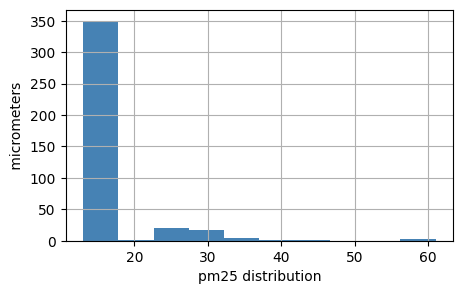

In [13]:
# import matplotlib as plt

# plt.figure(figsize=(5, 5))
#plt.subplot(2, 2, 1)

ax = dff['pm25'].hist(bins = 10, figsize=(5, 3), color = 'steelblue')
ax.set(xlabel="pm25 distribution", ylabel=" micrometers ")


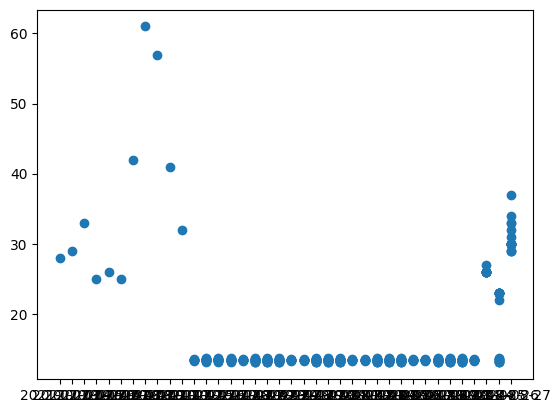

In [14]:
plt.pyplot.scatter(df['date'], df['pm25'])

#plt.figure(figsize=(9, 9))
#plt.subplot(2, 2, 1)
#ax.scatter(df['date'], df['pm25'])
# plt.title("График количества осадков")
# plt.ylabel("Количество осадков")
#plt.grid(True)
# ax.show()

#plt.title("Title")
#plt.show()

[Text(0.5, 0, 'pm10 distribution'), Text(0, 0.5, ' micrometers ')]

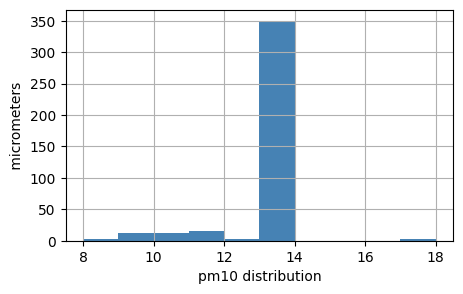

In [15]:
ax = dff['pm10'].hist(bins = 10, figsize=(5, 3), color = 'steelblue')
ax.set(xlabel="pm10 distribution", ylabel=" micrometers ")

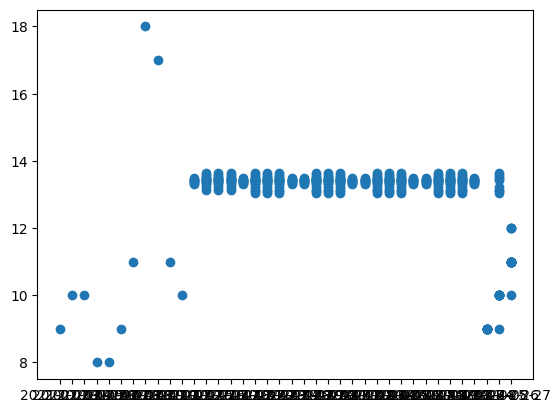

In [16]:
plt.pyplot.scatter(df['date'], df['pm10'])

[Text(0.5, 0, 'o3 distribution'), Text(0, 0.5, ' micrometers ')]

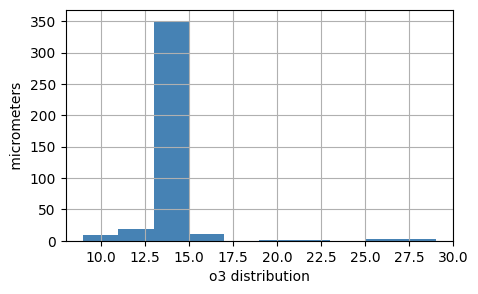

In [17]:
ax = dff['o3'].hist(bins = 10, figsize=(5, 3), color = 'steelblue')
ax.set(xlabel="o3 distribution", ylabel=" micrometers ")

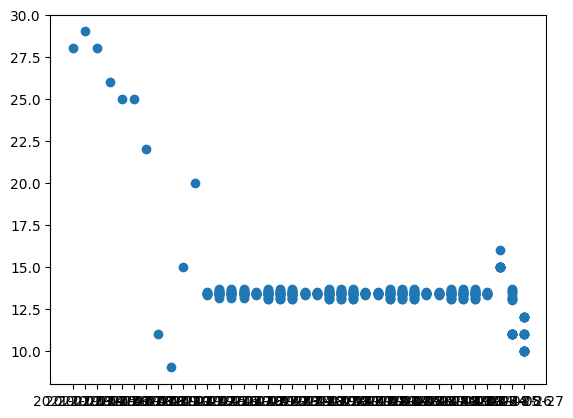

In [18]:
plt.pyplot.scatter(df['date'], df['o3'])
#df.pyplot.plot(kind='scatter', x=df['date'], y=df['o3'], color='red', label='Group 1')

In [19]:
# Correlation
ar_corr = dff.corr()
ar_corr

,pm25,pm10,o3
pm25,1.000000,-0.531389,0.096195
pm10,-0.531389,1.000000,-0.342590
o3,0.096195,-0.342590,1.000000


 Correlation matrix


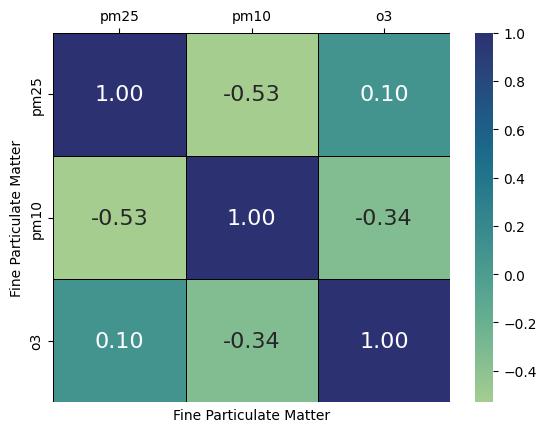

In [20]:
#import seaborn as sns
print(' Correlation matrix' )
figsize = (8,6)
ax = sns.heatmap(ar_corr, 
            annot=True,
            annot_kws={"size": 16},
            fmt=".2f",
            linewidth=.5, 
            cbar=True, 
            linecolor='black', 
            robust=True, 
            xticklabels=True,
            cmap="crest"
            #cmap=sns.cubehelix_palette(as_cmap=True) #'inferno')
 ) 
ax.set(xlabel="Fine Particulate Matter", ylabel="Fine Particulate Matter")
ax.xaxis.tick_top()

Air Pollution - Regression
Air Pollution  PM25, PM10 and o3


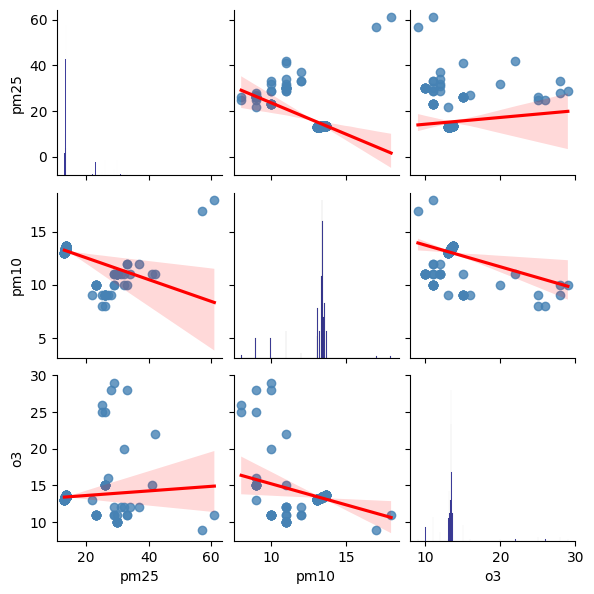

In [21]:
print('Air Pollution - Regression')

figsize = (6,6)
print(f'Air Pollution  PM25, PM10 and o3') 
pairplot = sns.pairplot(dff, 
                        kind='reg', 
                        plot_kws={'color': 'steelblue', 'line_kws':{'color':'red'}},
                        diag_kws = {'color': 'navy'},
                        corner = False,
                        height=2 )

Air Pollution - description


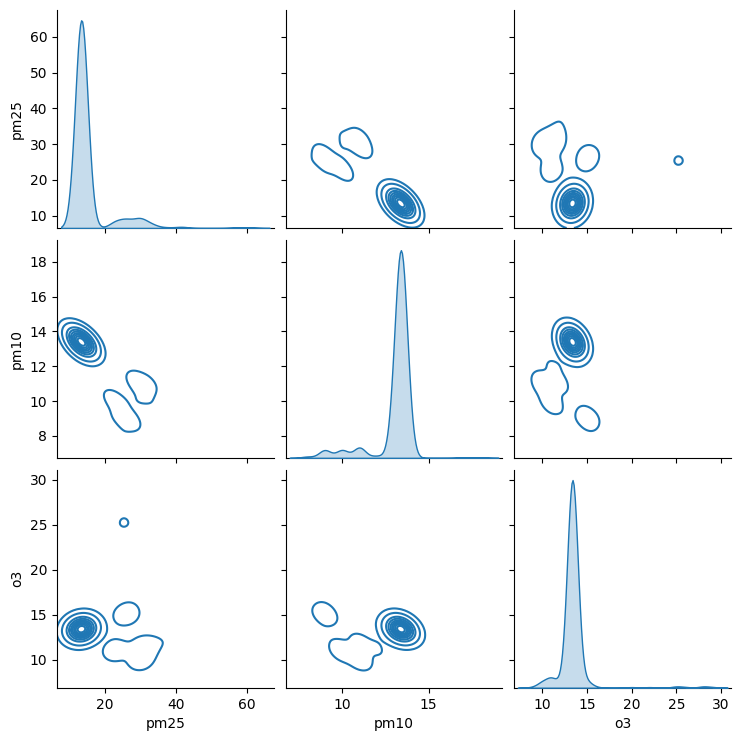

In [22]:
# 7 Air Pollution - description

print('Air Pollution - description')
figsize = (6,6)
sns.pairplot(dff, kind = "kde")

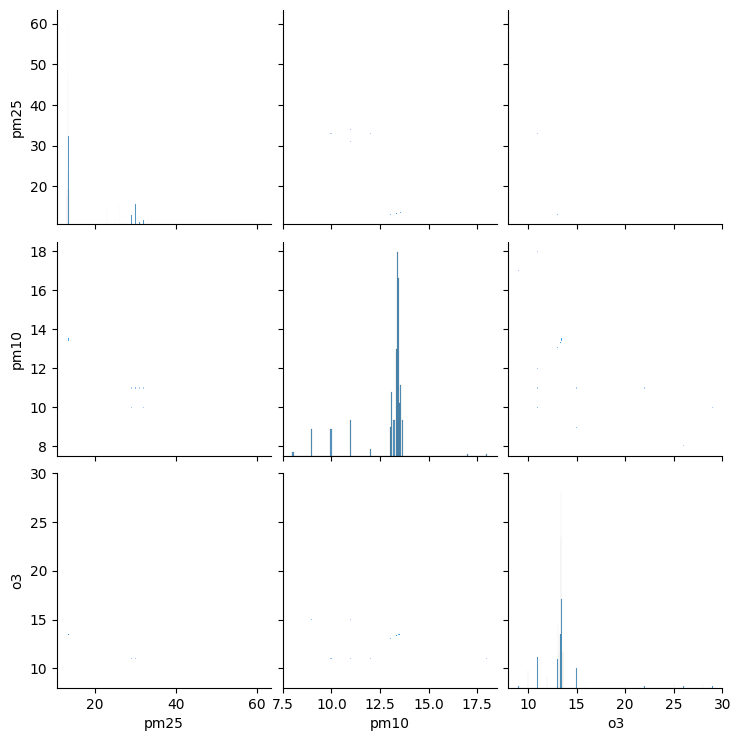

In [23]:
sns.pairplot(dff, kind = "hist")

 Fine particle count analysis


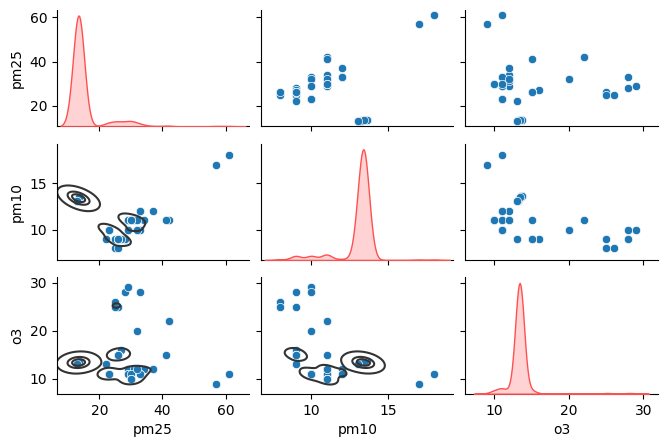

In [24]:
figsize = (6,6)
g = sns.pairplot(dff, 
                 diag_kind="kde", 
                 diag_kws = {'color': '#FF5050'}, 
                 height=1.5, 
                 aspect=1.5 )
g.map_lower(sns.kdeplot, levels=4, color=".2")
print(' Fine particle count analysis')

Air Pollution - description


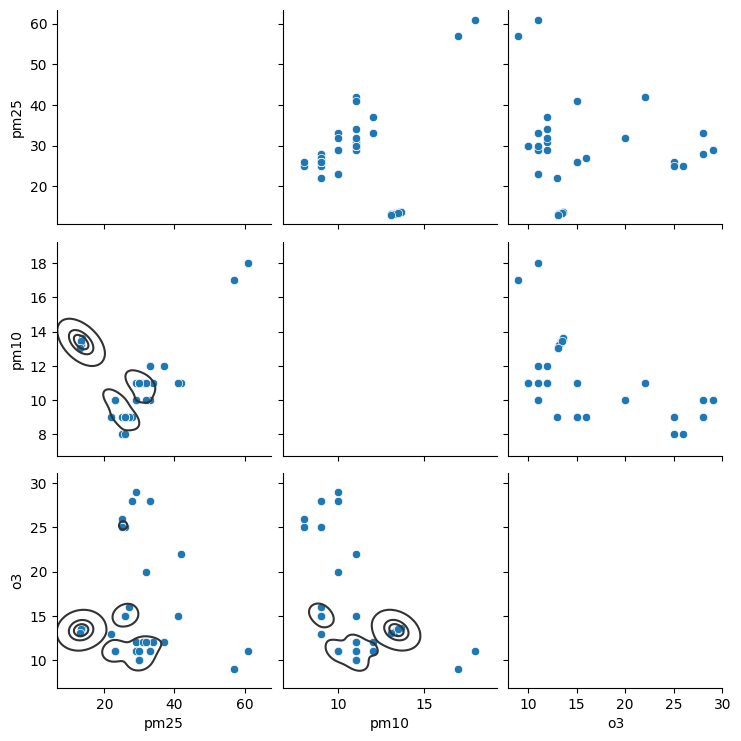

In [28]:
# 7 Air Pollution - description

print('Air Pollution - description')
figsize = (6,6)
g = sns.pairplot(dff, diag_kind="reg", diag_kws = {'color': '#FF5050'},)
g.map_lower(sns.kdeplot, levels=4, color=".2")